## Week 4:  More Interactive Data Viz, Working with Raster Data

Sep 19, 2019

## Today's Agenda

**Two parts:**

- Part 1: more interactive data visualization: the HoloViz ecosystem
- Part 2: getting started with raster data

## Part 1: More interactive data viz

## Recap: Data viz in Python

<center>
    <img src=attachment:landscape_hv_nx.png width=700></img>
</center>
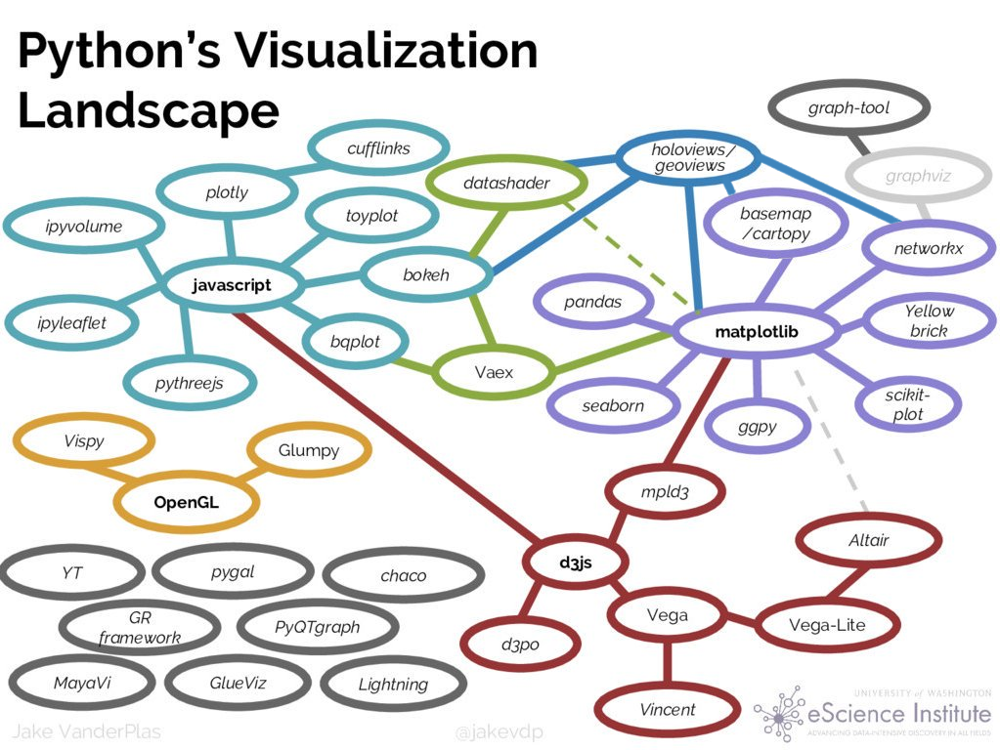

## What have we learned so far

### Matplotlib

- the classic, most flexible library
- can handle geographic data well
- overly verbose syntax, syntax is not declarative 

### Pandas

- quick, built-in interface
- not as many features as other libraries

### seaborn

- best for visualizing complex relationships between variables
- improves matplotlib's syntax: more declarative

### altair

- easy, declarative syntax
- lots of interactive features
- complex code with minimal amounts of code

## We'll learn one more today...

<center>
    <img src=attachment:landscape_hv_nx_pyviz.png width=600></img>
</center>
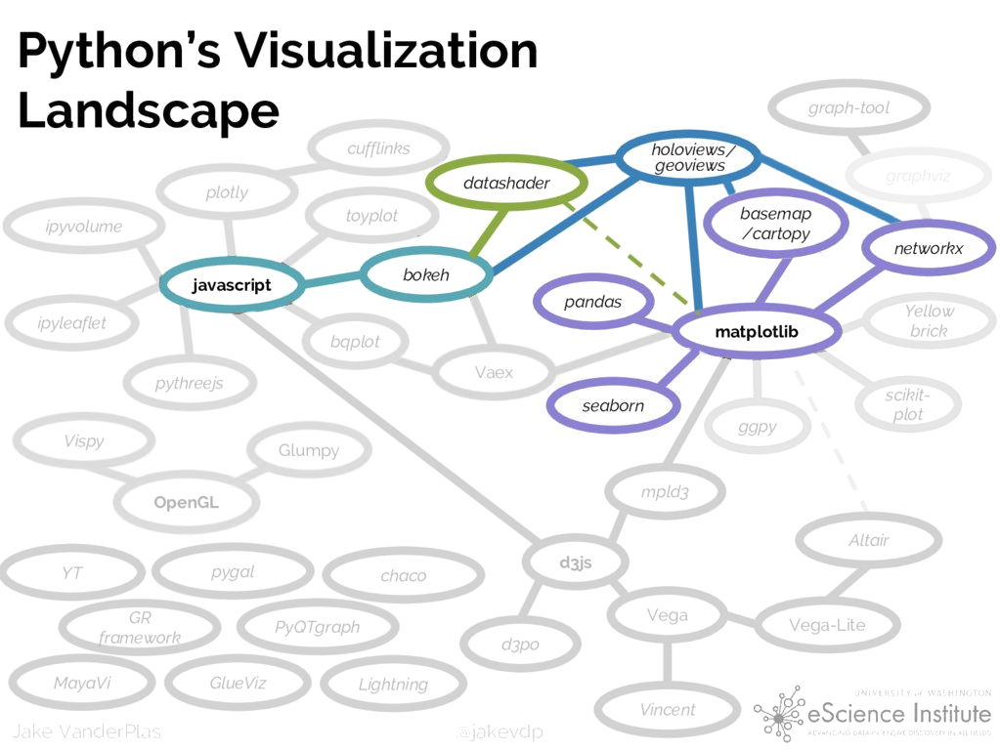

## A set of coordinated visualization libraries in Python

<center>
    <a href=https://holoviz.org/>
        <img src=attachment:Screen%20Shot%202019-09-19%20at%2012.43.29%20AM.png width=200></img>
    </a>
</center>
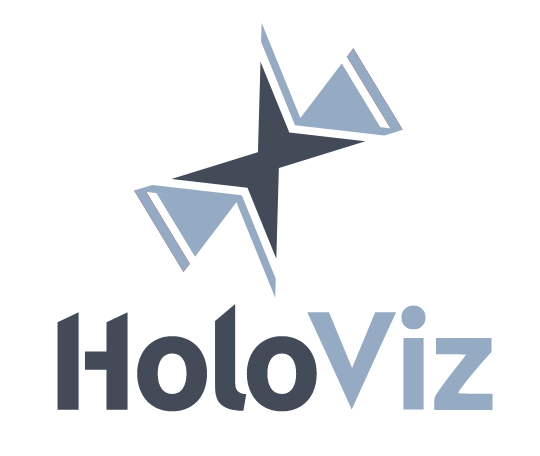

<center>
    <img src=attachment:Screen%20Shot%202019-09-19%20at%2012.46.03%20AM%201.png width=700></img>
</center>
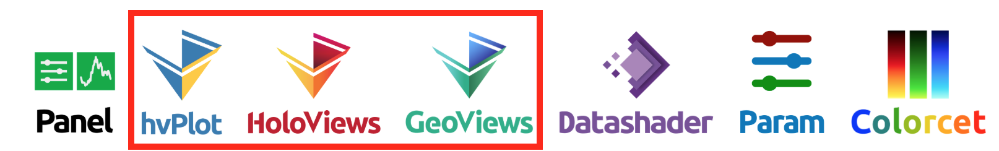

### Today: `hvPlot`, `Holoviews`, `Geoviews`

### Later in the course: `Datashader`, `Param`, `Panel`

## A quick overview

- **Bokeh**: creating interactive visualizations using Javascript using Python
- **HoloViews**: a declarative, high-level library for creating bokeh libraries

### $\rightarrow$ Similar to altair and Vega

## A significant pro: 

GeoViews builds on HoloViews to add support for geographic data

## The major con: 

- All are relatively new
- Bokeh is the most well-tested
- HoloViews, GeoViews, hvPlot are being actively developed but are very promising

## How does `hvPlot` fit in?

## The `hvPlot` package

It's **new**: officially released in February

In [1]:
%%html 

<center>
<blockquote class="twitter-tweet" data-lang="en"><p lang="en" dir="ltr">We are very pleased officially announce the release of hvPlot! It provides a high-level plotting API for the PyData ecosystem including <a href="https://twitter.com/pandas_dev?ref_src=twsrc%5Etfw">@pandas_dev</a>, <a href="https://twitter.com/xarray_dev?ref_src=twsrc%5Etfw">@xarray_dev</a>, <a href="https://twitter.com/dask_dev?ref_src=twsrc%5Etfw">@dask_dev</a>, <a href="https://twitter.com/geopandas?ref_src=twsrc%5Etfw">@geopandas</a> and more, generating interactive <a href="https://twitter.com/datashader?ref_src=twsrc%5Etfw">@datashader</a> and <a href="https://twitter.com/BokehPlots?ref_src=twsrc%5Etfw">@BokehPlots</a>. <a href="https://t.co/Loc5XElJUL">https://t.co/Loc5XElJUL</a></p>&mdash; HoloViews (@HoloViews) <a href="https://twitter.com/HoloViews/status/1092409050283819010?ref_src=twsrc%5Etfw">February 4, 2019</a></blockquote>
<script async src="https://platform.twitter.com/widgets.js" charset="utf-8"></script>
</center>


## Main use

- Quickly generate interactive plots from your data
- Seamlessly handles pandas and geopandas data
- Relies on Holoviews and Geoviews under the hood

An interface just like the `pandas` plot() function, but **much** more useful.

## Let's load some data to try out

In [2]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

In [3]:
plt.rcParams['figure.figsize'] = (10,6)

In [4]:
# let's load the measles data from week 2
url = "https://raw.githubusercontent.com/MUSA-620-Fall-2019/week-2/master/data/measles_incidence.csv"
measles_data_raw = pd.read_csv(url, skiprows=2, na_values='-')

In [5]:
measles_data_raw.head()

,YEAR,WEEK,ALABAMA,ALASKA,ARIZONA,ARKANSAS,CALIFORNIA,COLORADO,CONNECTICUT,DELAWARE,...,SOUTH DAKOTA,TENNESSEE,TEXAS,UTAH,VERMONT,VIRGINIA,WASHINGTON,WEST VIRGINIA,WISCONSIN,WYOMING
0,1928,1,3.67,NaN,1.90,4.11,1.38,8.38,4.50,8.58,...,5.69,22.03,1.18,0.4,0.28,NaN,14.83,3.36,1.54,0.91
1,1928,2,6.25,NaN,6.40,9.91,1.80,6.02,9.00,7.30,...,6.57,16.96,0.63,NaN,0.56,NaN,17.34,4.19,0.96,NaN
2,1928,3,7.95,NaN,4.50,11.15,1.31,2.86,8.81,15.88,...,2.04,24.66,0.62,0.2,1.12,NaN,15.67,4.19,4.79,1.36
3,1928,4,12.58,NaN,1.90,13.75,1.87,13.71,10.40,4.29,...,2.19,18.86,0.37,0.2,6.70,NaN,12.77,4.66,1.64,3.64
4,1928,5,8.03,NaN,0.47,20.79,2.38,5.13,16.80,5.58,...,3.94,20.05,1.57,0.4,6.70,NaN,18.83,7.37,2.91,0.91


## Convert from wide to long formats...

In [6]:
measles_data = measles_data_raw.melt(id_vars=["YEAR", "WEEK"], value_name="incidence", var_name="state")

In [7]:
measles_data.head()

,YEAR,WEEK,state,incidence
0,1928,1,ALABAMA,3.67
1,1928,2,ALABAMA,6.25
2,1928,3,ALABAMA,7.95
3,1928,4,ALABAMA,12.58
4,1928,5,ALABAMA,8.03


## Reminder: plotting with `pandas` 

The default `.plot()` doesn't know which variables to plot.

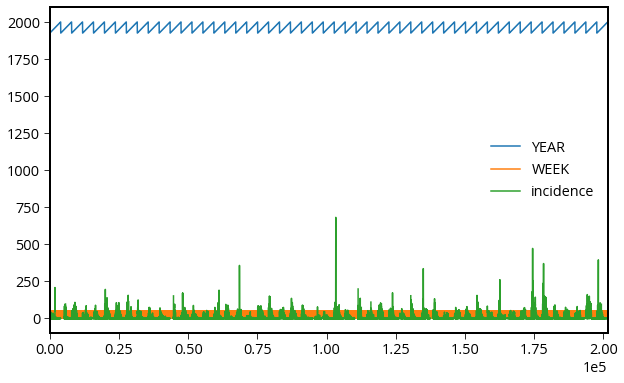

In [8]:
measles_data.plot();

But we can group by the year, and plot the national average each year

In [9]:
by_year = measles_data.groupby("YEAR")['incidence'].sum()
by_year.head()

YEAR
1928    16924.34
1929    12060.96
1930    14575.11
1931    15427.67
1932    14481.11
Name: incidence, dtype: float64

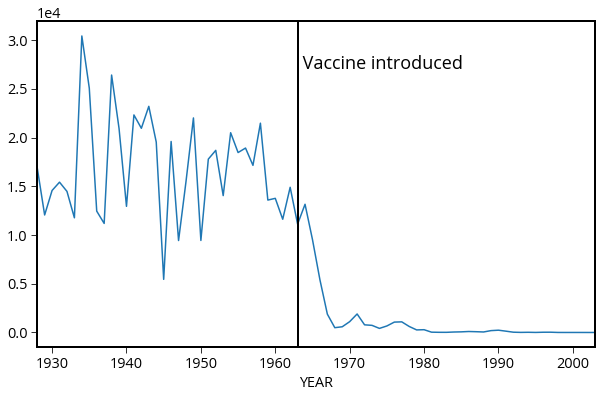

In [10]:
# plot the annual average by year
by_year.plot()

# Get the current axes
ax = plt.gca()

# add the vaccine year and label
ax.axvline(x=1963, c='k', linewidth=2)
ax.text(1963, 27000, " Vaccine introduced", ha='left', fontsize=18);

## Adding interactivity with `hvplot`

Use the `.hvplot()` to create interactive plots.

In [11]:
# this will add the .hvplot() function to your DataFrame!
import hvplot.pandas

In [12]:
img = by_year.hvplot(kind='line')
img

:Curve   [YEAR]   (incidence)

In this case, `.hvplot()` creates a `Holoviews` `Curve` object.

Not unlike `altair` `Chart` objects, it's an object that knows how to translate from your DataFrame data to a visualization.

In [13]:
print(img)

:Curve   [YEAR]   (incidence)


## Many different chart types are available...

In [14]:
by_year.hvplot(kind='scatter')

:Scatter   [YEAR]   (incidence)

In [15]:
by_year.hvplot(kind='bar', rot=90, width=1000)

:Bars   [YEAR]   (incidence)

## Just like in altair, we can also layer chart elements together

Use the `*` operator to layer together chart elements.

**Note:** the same thing can be accomplished in altair, but with the `+` operator. 

In [16]:
import holoviews as hv

# The line chart of incidence vs year
incidence = by_year.hvplot(kind='line')

# Vertical line + label for vaccine year
vline = hv.VLine(1963).opts(color='black')
label = hv.Text(1963, 27000, " Vaccine introduced", halign='left')

final_chart = incidence * vline * label
final_chart

:Overlay
   .Curve.Incidence :Curve   [YEAR]   (incidence)
   .VLine.I         :VLine   [x,y]
   .Text.I          :Text   [x,y]

## We can group charts by a specific column, with automatic widget selectors

This is some powerful magic.

Let's calculate the annual measles incidence for each year and state:

In [17]:
by_state = measles_data.groupby(['YEAR', 'state'])['incidence'].sum()
by_state.head()

YEAR  state     
1928  ALABAMA       334.99
      ALASKA          0.00
      ARIZONA       200.75
      ARKANSAS      481.77
      CALIFORNIA     69.22
Name: incidence, dtype: float64

Now, tell `hvplot` to plot produce charts for each state:

In [18]:
by_state_chart = by_state.hvplot(x='YEAR', 
                                 groupby='state', 
                                 width=400, 
                                 kind='line')

by_state_chart * vline

:DynamicMap   [state]
   :Overlay
      .Curve.Incidence :Curve   [YEAR]   (incidence)
      .VLine.I         :VLine   [x,y]

## We can select out individual charts from the set of grouped objects

In [19]:
PA = by_state_chart['PENNSYLVANIA'].relabel('PA')
NJ = by_state_chart['NEW JERSEY'].relabel('NJ') 

## Combine charts as subplots with the `+` operator

In [20]:
combined = PA + NJ     
combined

:Layout
   .Curve.PA :Curve   [YEAR]   (incidence)
   .Curve.NJ :Curve   [YEAR]   (incidence)

In [21]:
print(combined)

:Layout
   .Curve.PA :Curve   [YEAR]   (incidence)
   .Curve.NJ :Curve   [YEAR]   (incidence)


The charts are side-by-side by default. You can also specify the number of rows/columns explicitly.

In [22]:
# one column
combined.cols(1)

:Layout
   .Curve.PA :Curve   [YEAR]   (incidence)
   .Curve.NJ :Curve   [YEAR]   (incidence)

## We can also show overlay lines on the sample plot

Using the `by` keyword:

In [23]:
states = states = ['NEW YORK', 'NEW JERSEY', 'CALIFORNIA', 'PENNSYLVANIA']
sub_states = by_state.loc[:, states]

sub_states.hvplot(x='YEAR', by='state', kind='line') * vline

:Overlay
   .NdOverlay.Incidence :NdOverlay   [state]
      :Curve   [YEAR]   (incidence)
   .VLine.I             :VLine   [x,y]

## We can also show faceted plots

Just like in altair, when we used the `alt.Chart().facet(column='state')` syntax 

Below, we specify the `state` column should be mapped to each column:

In [24]:
img = sub_states.hvplot(x="YEAR", col="state", kind="line", rot=90) * vline
img

:GridSpace   [state]
   :Overlay
      .Curve.Incidence :Curve   [YEAR]   (incidence)
      .VLine.I         :VLine   [x,y]

## Functions for each kind of chart type are available too

In [25]:
by_state.hvplot

## For example, we could plot a bar chart for these four states

In [26]:
by_state.loc[1960:1970, states].hvplot.bar(x='YEAR', 
                                           y='incidence', 
                                           by='state', rot=90)

:Bars   [YEAR,state]   (incidence)

Change `bar()` to `line()` and we get the same thing as before.

In [27]:
by_state.loc[1960:1970, states].hvplot.line(x='YEAR', 
                                            y='incidence', 
                                            by='state', rot=90)

:NdOverlay   [state]
   :Curve   [YEAR]   (incidence)

## Customizing charts

See the help message for explicit hvplot functions:

In [42]:
by_state.hvplot?

In [41]:
by_state.hvplot.line?

## Heatmaps are available too...

Can we reproduce the [WSJ measles heatmap](http://graphics.wsj.com/infectious-diseases-and-vaccines/) that we made in altair in week 2? 

Use the help function:

In [28]:
measles_data.hvplot.heatmap?

## Two methods:

We want to plot 'YEAR' on the x axis, 'state' on the y axis, and specify 'incidence' as the values begin plotted in each heatmap bin.

1. Use the original, tidy data (`measles_data`) with columns for state, week, year, and incidence
    - you will need to use the `reduce_function` keyword to sum over weeks
1. You can use the `by_state` data frame which has already summed over weeks for each state

In [29]:
# METHOD #1: just plot the incidence
heatmap = by_state.hvplot.heatmap(
    x="YEAR", y="state", C="incidence", height=500, width=1000, flip_yaxis=True, rot=90
)
heatmap.redim(state="State", YEAR="Year")

:HeatMap   [Year,State]   (incidence)

In [30]:
## METHOD 2: hvplot does the aggregation
heatmap = measles_data.hvplot.heatmap(
    x="YEAR",
    y="state",
    C="incidence",
    reduce_function=np.sum,
    height=500,
    width=1000,
    flip_yaxis=True,
    rot=90,
)
heatmap.redim(state="State", YEAR="Year")

:HeatMap   [Year,State]   (incidence)

## Just like altair: save the file as html

In [31]:
import hvplot
hvplot.save(heatmap, 'measles.html')

In [33]:
# load the html file and display it
from IPython.display import HTML
HTML('measles.html')

## One last thing: scatter matrix plots

Visualizing relationships between variables, as we have seen in [seaborn](https://seaborn.pydata.org/examples/scatterplot_matrix.html) and [altair](https://altair-viz.github.io/gallery/scatter_matrix.html)

Let's load the cars data set from week 2

In [34]:
url = "https://raw.githubusercontent.com/MUSA-620-Spring-2019/week-2/master/data/cars.csv"
cars = pd.read_csv(url)

In [35]:
cars.head()

,Acceleration,Cylinders,Displacement,Horsepower,Miles_per_Gallon,Name,Origin,Weight_in_lbs,Year
0,12.0,8,307.0,130.0,18.0,chevrolet chevelle malibu,USA,3504,1970-01-01
1,11.5,8,350.0,165.0,15.0,buick skylark 320,USA,3693,1970-01-01
2,11.0,8,318.0,150.0,18.0,plymouth satellite,USA,3436,1970-01-01
3,12.0,8,304.0,150.0,16.0,amc rebel sst,USA,3433,1970-01-01
4,10.5,8,302.0,140.0,17.0,ford torino,USA,3449,1970-01-01


Use the `hvplot.scatter_matrix()` function:

In [36]:
hvplot.scatter_matrix?

In [37]:
columns = ['Horsepower', 'Acceleration', 
           'Miles_per_Gallon', 'Origin']
hvplot.scatter_matrix(cars[columns], c='Origin')

:GridMatrix   [X,Y]
   :NdOverlay   [Origin]
      :Histogram   [Miles_per_Gallon]   (Miles_per_Gallon_frequency)

Note the "box select" and "lasso" features on the tool bar for interactions

## Recap: altair vs hvplot

- both use a declarative syntax (altair more so than hvplot)
- users of ggplot might be more familiar with altair's syntax
- hvplot integrates directly into pandas dataframes via the `.hvplot()` function

- both have support for cross-filtering and interactions
- both can be incorporated into web-based dashboard via HTML (later in course)
- hvplot has better support for large data (later in course)

#### It's largely up to you which one you feel is easier to use

## hvplot can also be used with geopandas!

Let's load some geographic data for countries:

In [38]:
import geopandas as gpd
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

In [39]:
world.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,920938,Oceania,Fiji,FJI,8374.0,"(POLYGON ((180 -16.06713266364245, 180 -16.555..."
1,53950935,Africa,Tanzania,TZA,150600.0,POLYGON ((33.90371119710453 -0.950000000000000...
2,603253,Africa,W. Sahara,ESH,906.5,POLYGON ((-8.665589565454809 27.65642588959236...
3,35623680,North America,Canada,CAN,1674000.0,"(POLYGON ((-122.84 49.00000000000011, -122.974..."
4,326625791,North America,United States of America,USA,18560000.0,"(POLYGON ((-122.84 49.00000000000011, -120 49...."


## Plotting with just geopandas

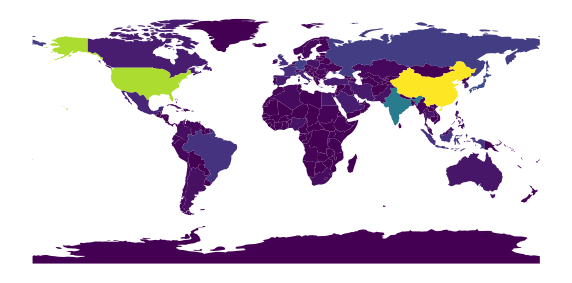

In [40]:
fig, ax = plt.subplots(figsize=(10,10))
world.plot(column='gdp_md_est', ax=ax)
ax.set_axis_off()

## Now with hvplot

In [41]:
world.hvplot.polygons?

In [42]:
# can also just do world.hvplot()
world.hvplot.polygons(c='gdp_md_est', geo=True, height=400)

/Users/nhand/anaconda3/envs/py37/lib/python3.7/site-packages/datashader/transfer_functions.py:21: FutureWarning: xarray subclass Image should explicitly define __slots__
  class Image(xr.DataArray):


:Polygons   [Longitude,Latitude]   (pop_est,continent,name,iso_a3,gdp_md_est)

## Let's try it on our median assessment values per neighborhood from last week

If you recall last week's exercise...

In [43]:
import geopandas as gpd
from shapely.geometry import Point

In [44]:
# Load the data
url = "https://raw.githubusercontent.com/MUSA-620-Fall-2019/week-3/master/data/opa_residential.csv"
data = pd.read_csv(url)

# Create the Point() objects
data['Coordinates'] = list(zip(data['lng'], data['lat']))
data['Coordinates'] = data['Coordinates'].apply(Point)

# Create the GeoDataFrame
input_crs = {'init': 'epsg:4326'}
data = gpd.GeoDataFrame(data, geometry='Coordinates', crs=input_crs)

In [45]:
# load the Zillow data from GitHub
url = "https://raw.githubusercontent.com/MUSA-620-Fall-2019/week-3/master/data/zillow_neighborhoods.geojson"
zillow = gpd.read_file(url)

In [46]:
# Important: Make sure the CRS match
data = data.to_crs(zillow.crs)

# perform the spatial join
gdata = gpd.sjoin(data, zillow, op='within', how='left')

/Users/nhand/anaconda3/envs/py37/lib/python3.7/site-packages/numpy/lib/function_base.py:2167: RuntimeWarning: invalid value encountered in ? (vectorized)
  outputs = ufunc(*inputs)


In [47]:
# Calculate the median market value per Zillow neighborhood
median_values = gdata.groupby('ZillowName')['market_value'].median().reset_index()

# Merge median values with the Zillow geometries
median_values = zillow.merge(median_values, on='ZillowName')
print(type(median_values))

<class 'geopandas.geodataframe.GeoDataFrame'>


In [48]:
median_values.head()

,ZillowName,geometry,market_value
0,Academy Gardens,POLYGON ((-74.99850760499999 40.06434635800008...,185950.0
1,Allegheny West,POLYGON ((-75.16592149899998 40.00327234900004...,34750.0
2,Andorra,POLYGON ((-75.22462652999997 40.06686047600004...,251900.0
3,Aston Woodbridge,POLYGON ((-75.00859651999997 40.05368637200007...,183800.0
4,Bartram Village,POLYGON ((-75.20732671899998 39.93349938500006...,48300.0


In [49]:
print(median_values.crs)

{'init': 'epsg:4326'}


In [50]:
# pass arguments directly to hvplot() 
# and it recognizes polygons automatically
median_values.hvplot(c='market_value', width=600, height=500, geo=True)

:Polygons   [Longitude,Latitude]   (ZillowName,market_value)

## Now we can take advantage of GeoViews

Let's add a tile source underneath the choropleth map

In [51]:
import geoviews as gv
import geoviews.tile_sources as gvts

In [52]:
%%opts WMTS [width=800, height=800, xaxis=None, yaxis=None]

choro = median_values.hvplot(c='market_value', width=500, 
                             height=400, alpha=0.5, geo=True)
gvts.ESRI * choro

:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (ZillowName,market_value)

## Many of the most common tile sources are available..

In [53]:
print(type(gvts.ESRI))

<class 'geoviews.element.geo.WMTS'>


In [54]:
%%opts WMTS [width=200, height=200, xaxis=None, yaxis=None]

(gvts.OSM + gvts.Wikipedia + gvts.StamenToner + gvts.EsriNatGeo +
 gvts.EsriImagery + gvts.EsriUSATopo + gvts.EsriTerrain + gvts.CartoDark).cols(4)

:Layout
   .WMTS.I    :WMTS   [Longitude,Latitude]
   .WMTS.II   :WMTS   [Longitude,Latitude]
   .WMTS.III  :WMTS   [Longitude,Latitude]
   .WMTS.IV   :WMTS   [Longitude,Latitude]
   .WMTS.V    :WMTS   [Longitude,Latitude]
   .WMTS.VI   :WMTS   [Longitude,Latitude]
   .WMTS.VII  :WMTS   [Longitude,Latitude]
   .WMTS.VIII :WMTS   [Longitude,Latitude]

**Note**: we've used the `%%opts` cell magic to apply syling options to any charts generated in the cell.

See [the documentation guide on customizations](http://holoviews.org/user_guide/Notebook_Magics.html) for more details.

## Check out the documentation

- [Hvplot user guide](https://hvplot.pyviz.org/user_guide/index.html)
- [HoloViz tutorial](https://holoviz.org/talks/index.html): introduction to the HoloViz ecosystem
- [HoloViews user guide](http://holoviews.org/user_guide/index.html) and [gallery](http://holoviews.org/gallery/index.html)
- [GeoViews user guide](http://geoviews.org/user_guide/index.html) and [gallery](http://geoviews.org/gallery/index.html)

Some **very cool** examples available in the galleries

## Let's take a break...

## Part 2: Working with raster data sets

- So far we've been working mainly with *vector* data: lines, points, polygons.
- The basemaps we've been adding are an exampe of *raster* data
- **Raster data:**
    - Gridded or pixelated
    - Maps easily to an array — it's the representation for digital images

<img src=attachment:Screen%20Shot%202019-09-19%20at%201.52.13%20AM.png width=700></img>
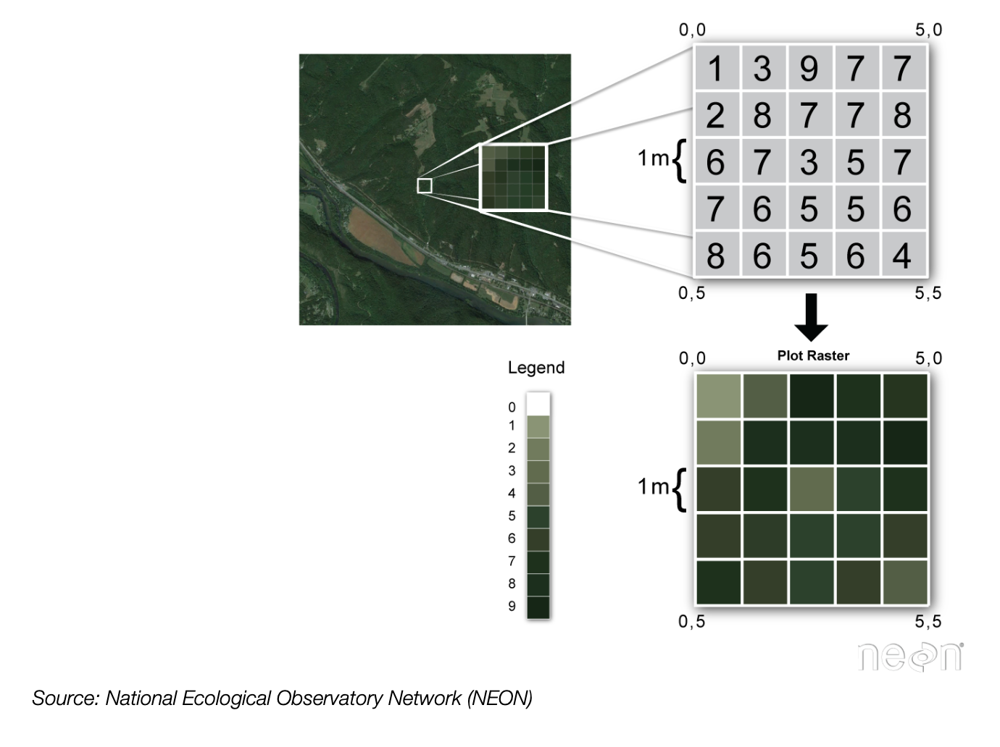

## Continuous raster examples

- Multispectral satellite imagery, e.g., the Landsat satellite
- Digital Elevation Models (DEMs)
- Maps of canopy height derived from LiDAR data.

## Categorical raster examples

- Land cover or land-use maps.
- Tree height maps classified as short, medium, and tall trees.
- Snowcover masks (binary snow or no snow)

## Important attributes of raster data

### 1. The coordinate reference system 

<img src=attachment:Screen%20Shot%202019-09-19%20at%202.12.31%20AM.png width=600>
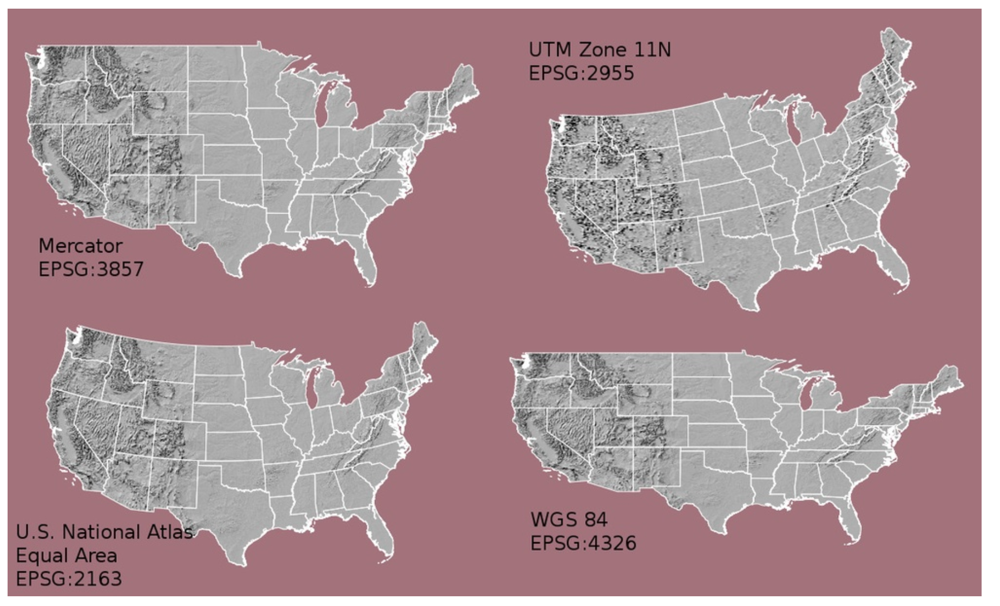

### 2. Resolution

The spatial distance that a single pixel covers on the ground.

<img src=attachment:Screen%20Shot%202019-09-19%20at%202.14.16%20AM.png width=700>
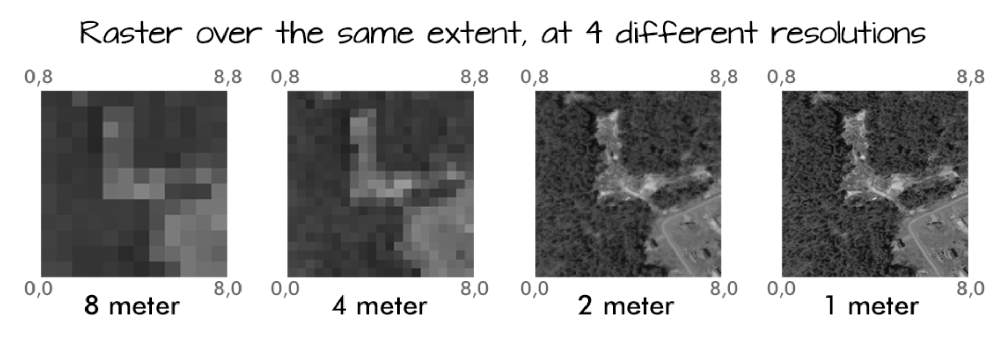

### 3. Extent

The bounding box that covers the entire extent of the raster data.

<img src=attachment:Screen%20Shot%202019-09-19%20at%202.15.02%20AM.png width=700>
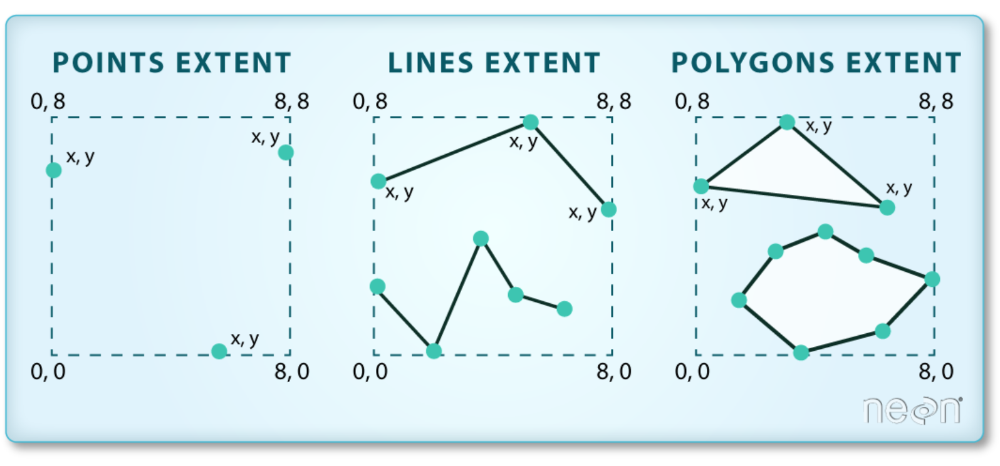

### 4. Affine transformation

Pixel space --> real space

- A mapping from pixel space (rows and columns of the image) to the x and y coordinates defined by the CRS
- Typically a six parameter matrix defining the origin, pixel resolution, and rotation of the raster image

## Multi-band raster data

Each band measures the light reflected from different parts of the electromagnetic spectrum. 

<img src=attachment:Screen%20Shot%202019-09-19%20at%202.23.35%20AM.png width=800></img>
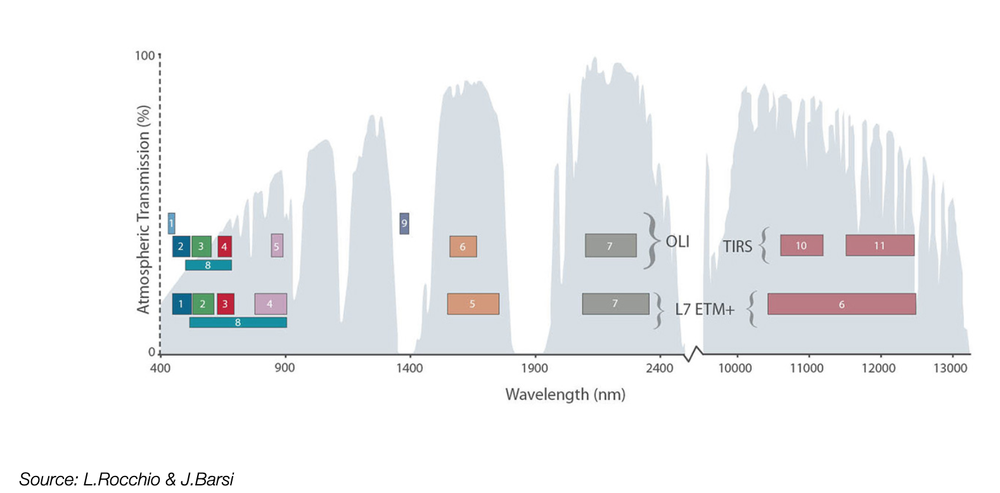

## Color images are multi-band rasters!

<img src=attachment:Screen%20Shot%202019-09-19%20at%202.25.43%20AM.png width=800></img>
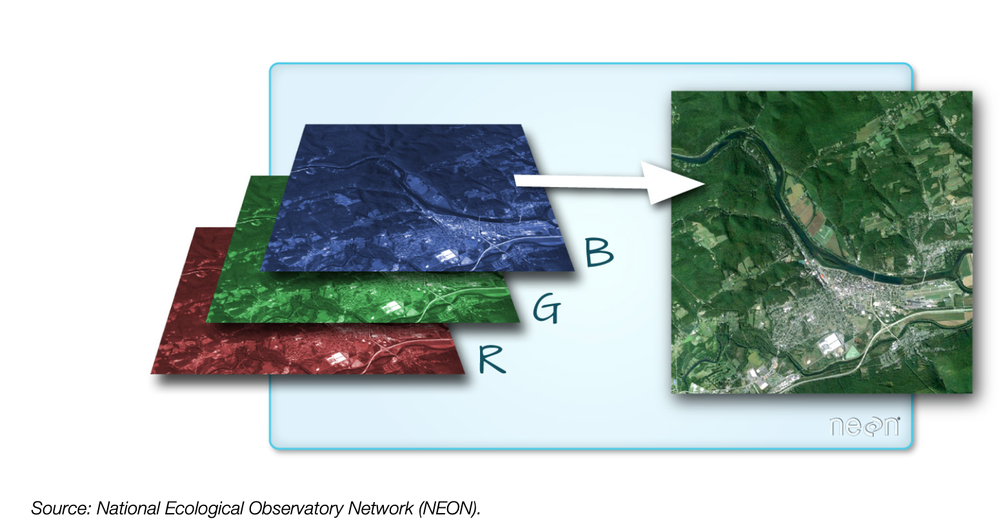

## The raster format: GeoTIFF

- A standard .tif image format with additional spatial information embedded in the file, which includes metadata for: 

- Geotransform, e.g., extent, resolution
- Coordinate Reference System (CRS)
- Values that represent missing data (`NoDataValue`)

## Tools for raster data 

- Lots of different options: really just working with arrays
- One of the first options: Geospatial Data Abstraction Library (GDAL)
    - Low level and not really user-friendly
- A more recent, much more Pythonic package: `rasterio`

We'll use `rasterio` for the majority of our raster analysis

## Getting started with rasterio

Analysis is built around the "open()" command which returns a "dataset" or "file handle"

In [55]:
import rasterio as rio

In [56]:
# Open the file and get a file "handle"
landsat = rio.open("./data/landsat8_philly.tif")
landsat

<open DatasetReader name='./data/landsat8_philly.tif' mode='r'>

## Let's check out the metadata


In [57]:
# The CRS
landsat.crs

CRS.from_epsg(32618)

In [58]:
# The bounds
landsat.bounds

BoundingBox(left=476064.3596176505, bottom=4413096.927074196, right=503754.3596176505, top=4443066.927074196)

In [59]:
# The number of bands available
landsat.count

10

In [60]:
# The band numbers that are available
landsat.indexes

(1, 2, 3, 4, 5, 6, 7, 8, 9, 10)

In [61]:
# Number of pixels in the x and y directions
landsat.shape

(999, 923)

In [62]:
# The 6 parameters that map from pixel to real space
landsat.transform

Affine(30.0, 0.0, 476064.3596176505,
       0.0, -30.0, 4443066.927074196)

In [63]:
# All of the meta data
landsat.meta

{'driver': 'GTiff',
 'dtype': 'uint16',
 'nodata': None,
 'width': 923,
 'height': 999,
 'count': 10,
 'crs': CRS.from_epsg(32618),
 'transform': Affine(30.0, 0.0, 476064.3596176505,
        0.0, -30.0, 4443066.927074196)}

## Reading data from a file

Tell the file which band to read, **starting with 1**

In [64]:
# This is just a numpy array
data = landsat.read(1)
data

array([[10901, 10618, 10751, ..., 12145, 11540, 14954],
       [11602, 10718, 10546, ..., 11872, 11982, 12888],
       [10975, 10384, 10357, ..., 11544, 12318, 12456],
       ...,
       [12281, 12117, 12072, ..., 11412, 11724, 11088],
       [12747, 11866, 11587, ..., 11558, 12028, 10605],
       [11791, 11677, 10656, ..., 10615, 11557, 11137]], dtype=uint16)

We can plot it with matplotlib's `imshow`

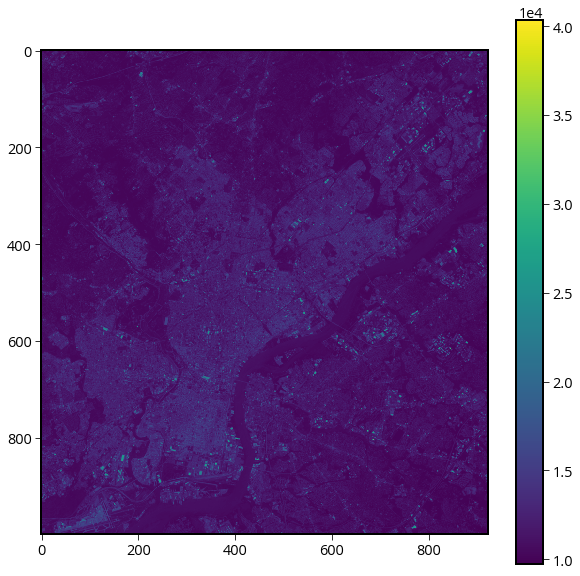

In [65]:
fig, ax = plt.subplots(figsize=(10,10))
img = ax.imshow(data)
# Add a colorbar
plt.colorbar(img)

## Two improvements

- A log-scale colorbar
- Add the axes extent

## Adding the axes extent

Note that imshow needs a bounding box of the form: (left, right, bottom, top). See the documentation for `imshow` if you forget the right ordering...

## Using a log-scale color bar

Matplotlib has a built in log normalization...

In [66]:
import matplotlib.colors as mcolors

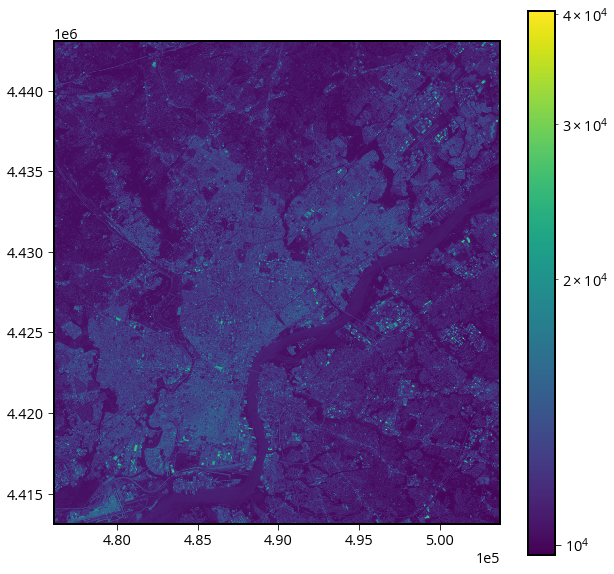

In [67]:
# Initialize
fig, ax = plt.subplots(figsize=(10, 10))

img = ax.imshow(
    data,
    norm=mcolors.LogNorm(),
    extent=[
        landsat.bounds.left,
        landsat.bounds.right,
        landsat.bounds.bottom,
        landsat.bounds.top,
    ],
)

# Add a colorbar
plt.colorbar(img)

## Overlaying vector geometries on raster plots

Two requirements:

1. The CRS of the two datasets must match
1. The extent of the imshow plot must be set properly

## Let's add the city limits

In [68]:
import geopandas as gpd

In [69]:
city_limits = gpd.read_file("./data/City_Limits.geojson")

In [70]:
# Convert to the correct CRS!
print(landsat.crs.data)

{'init': 'epsg:32618'}


In [71]:
city_limits = city_limits.to_crs(landsat.crs.data)

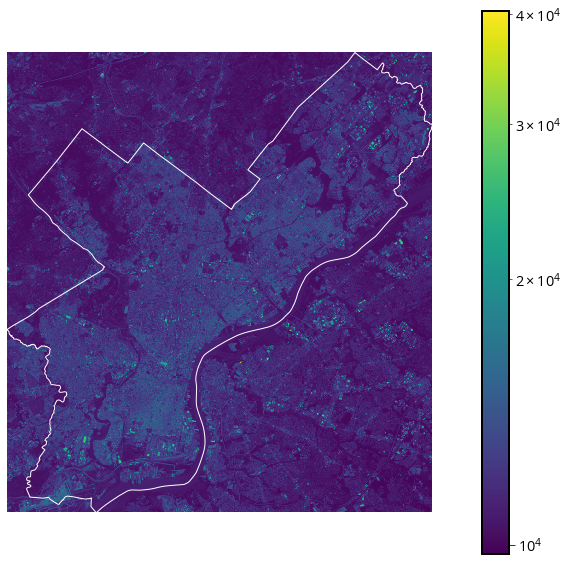

In [73]:
# Initialize
fig, ax = plt.subplots(figsize=(10, 10))

landsat_extent = [
    landsat.bounds.left,
    landsat.bounds.right,
    landsat.bounds.bottom,
    landsat.bounds.top,
]

img = ax.imshow(data, norm=mcolors.LogNorm(), extent=landsat_extent)

# Add the city limits
city_limits.plot(ax=ax, facecolor="none", edgecolor="white")

# Add a colorbar
plt.colorbar(img)
ax.set_axis_off()

## What band did we plot??

Landsat 8 has 11 bands spanning the electromagnetic spectrum from visible to infrared. 

<img src=attachment:Screen%20Shot%202019-09-19%20at%203.04.07%20AM.png width=700></img>
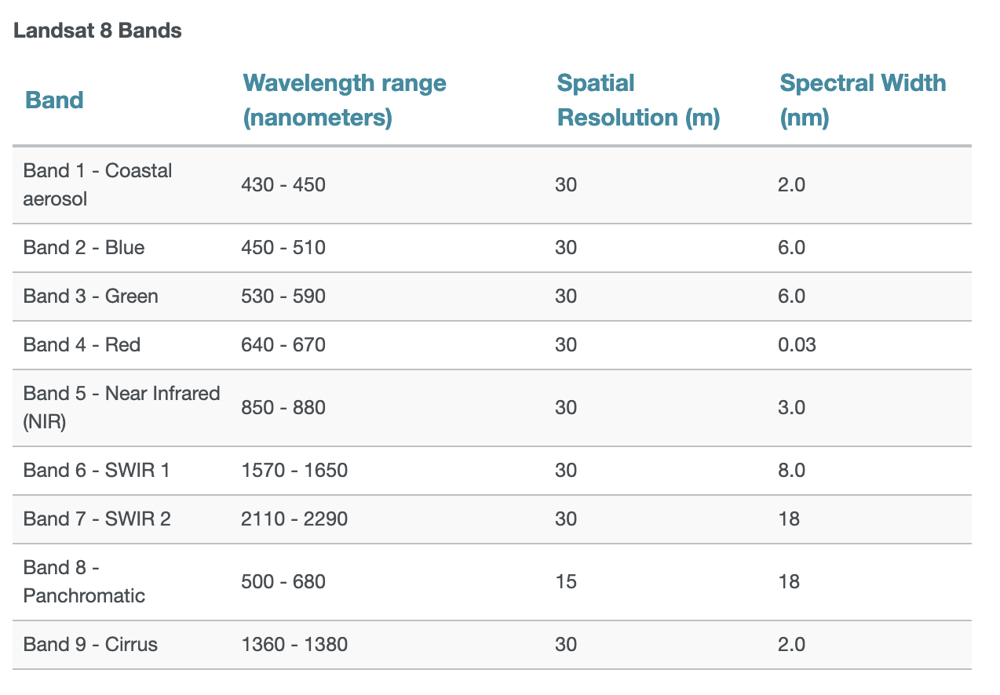

## How about a typical RGB color image?

First let's read the red, blue, and green bands (bands 4, 3, 2):

In [74]:
rgb_data = landsat.read([4, 3, 2])

In [75]:
rgb_data.shape

(3, 999, 923)

Note the data has the shape: (bands, width, height)

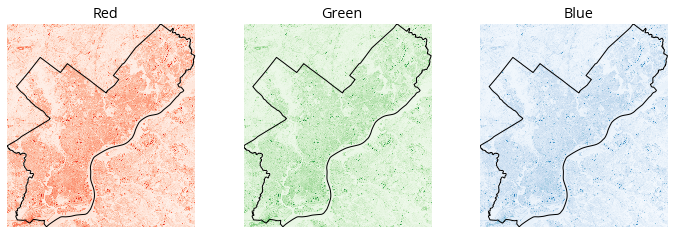

In [77]:
fig, axs = plt.subplots(ncols=3, figsize=(12, 6))

cmaps = ["Reds", "Greens", "Blues"]
for i in [0, 1, 2]:

    # this subplot axes
    ax = axs[i]

    # Plot
    ax.imshow(rgb_data[i], norm=mcolors.LogNorm(), extent=landsat_extent, cmap=cmaps[i])
    city_limits.plot(ax=ax, facecolor="none", edgecolor="black")

    # Format
    ax.set_axis_off()
    ax.set_title(cmaps[i][:-1])

## Use `earthpy` to plot the combined color image

A useful utility package to perform the proper re-scaling of pixel values

In [78]:
import earthpy.plot as ep

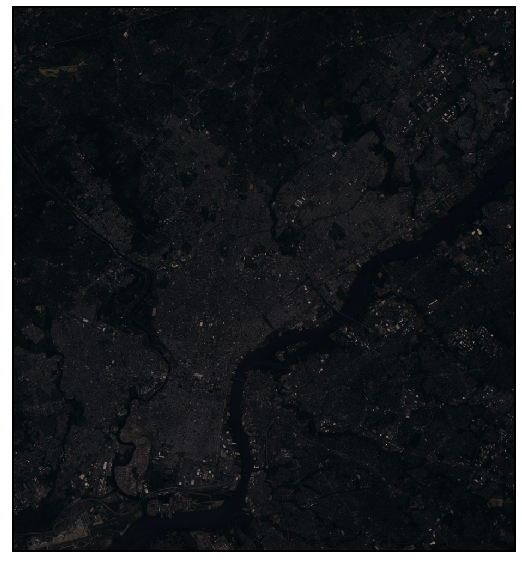

In [79]:
# Initialize
fig, ax = plt.subplots(figsize=(10,10))

# Plot the RGB bands
ep.plot_rgb(rgb_data, rgb=(0, 1, 2), ax=ax);

## We can "stretch" the data to improve the brightness

<img src=attachment:Screen%20Shot%202019-09-19%20at%203.05.42%20AM.png width=700></img>
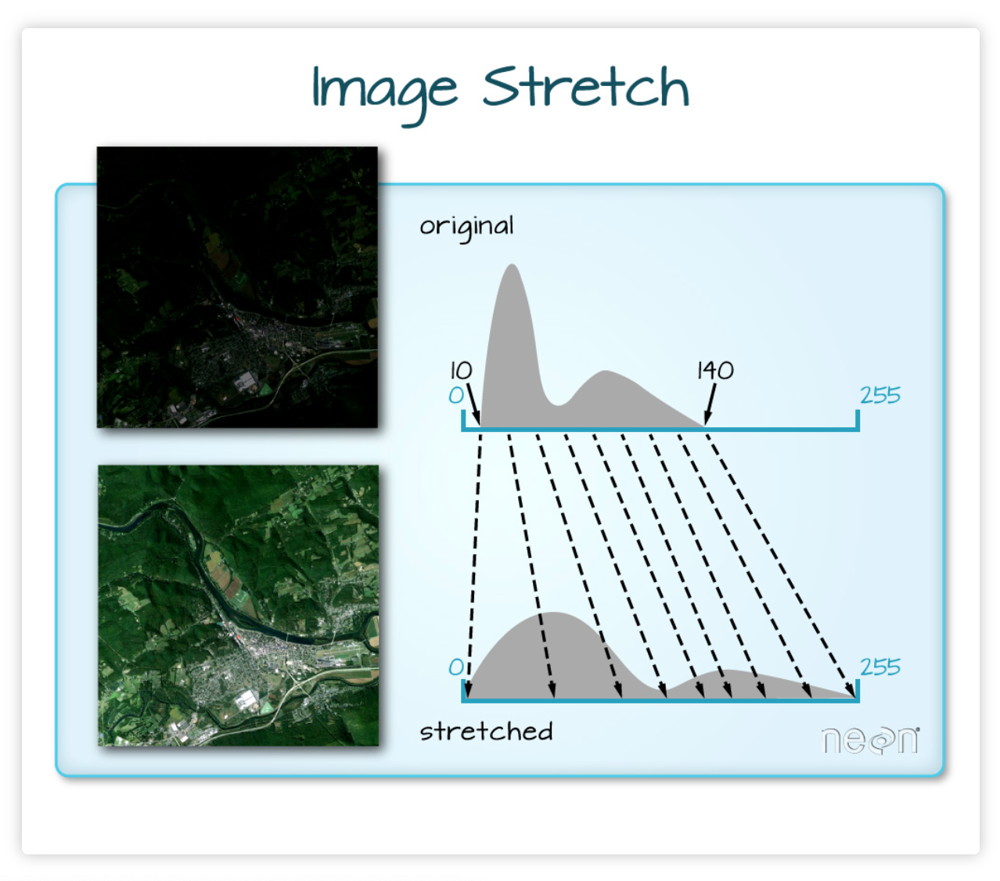

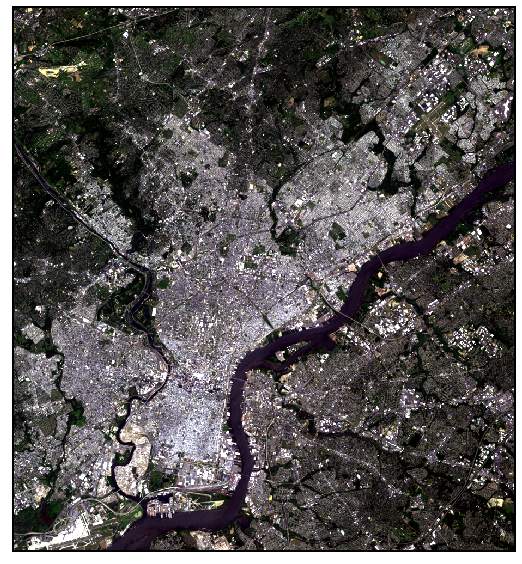

In [80]:
# Initialize
fig, ax = plt.subplots(figsize=(10,10))

# Plot the RGB bands
ep.plot_rgb(rgb_data, rgb=(0, 1, 2), ax=ax, stretch=True);

## Working with multi-band data is a bit messy

Can we do better?

## Yes! Holoviz to the rescue...

<img src=attachment:dataset-diagram-logo.png width=600>
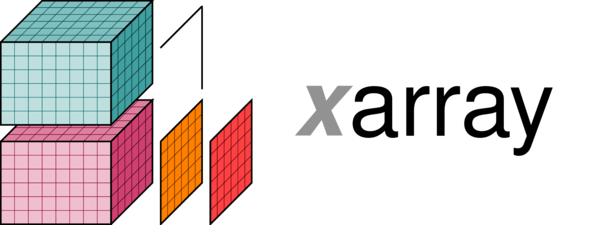

## xarray

- A fancier version of numpy arrays
- Designed for gridded data with multiple dimensions
- For raster data, those dimensions are: bands, latitude, longitude, pixel values

## Let's try it out...

In [81]:
import xarray as xr

In [110]:
xr.open_rasterio?

In [82]:
ds = xr.open_rasterio("./data/landsat8_philly.tif")
ds

<xarray.DataArray (band: 10, y: 999, x: 923)>
[9220770 values with dtype=uint16]
Coordinates:
  * band     (band) int64 1 2 3 4 5 6 7 8 9 10
  * y        (y) float64 4.443e+06 4.443e+06 4.443e+06 ... 4.413e+06 4.413e+06
  * x        (x) float64 4.761e+05 4.761e+05 4.761e+05 ... 5.037e+05 5.037e+05
Attributes:
    transform:      (30.0, 0.0, 476064.3596176505, 0.0, -30.0, 4443066.927074...
    crs:            +init=epsg:32618
    res:            (30.0, 30.0)
    is_tiled:       0
    nodatavals:     (nan, nan, nan, nan, nan, nan, nan, nan, nan, nan)
    scales:         (1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0)
    offsets:        (0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0)
    AREA_OR_POINT:  Area

## Now the magic begins: more hvplot

Still experimental, but very promising — interactive plots with widgets for each band!

In [83]:
import hvplot.xarray

In [84]:
img = ds.hvplot.image(width=700, height=500, cmap='viridis')
img

:DynamicMap   [band]
   :Image   [x,y]   (value)

## Two key raster concepts

- Using vector + raster data
    - Cropping or masking raster data based on vector polygons
- Raster math and zonal statistics
    - Combining multiple raster data sets
    - Calculating statistics within certain vector polygons

## Cropping: let's trim to just the city limits

Use rasterio's builtin mask function:

In [85]:
from rasterio.mask import mask

In [86]:
masked, mask_transform = mask(
    dataset=landsat, 
    shapes=city_limits.geometry, 
    crop=True, # remove pixels not within boundary
    all_touched=True, # get all pixels that touch the boudnary
    filled=False # do not fill cropped pixels with a default value
)

In [87]:
masked

masked_array(
  data=[[[--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         ...,
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --]],

        [[--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         ...,
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --]],

        [[--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         ...,
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --]],

        ...,

        [[--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --, --, --],
         ...,
         [--, --, --, ..., --, --, --],
         [--, --, --, ..., --,

In [88]:
masked.shape

(10, 999, 923)

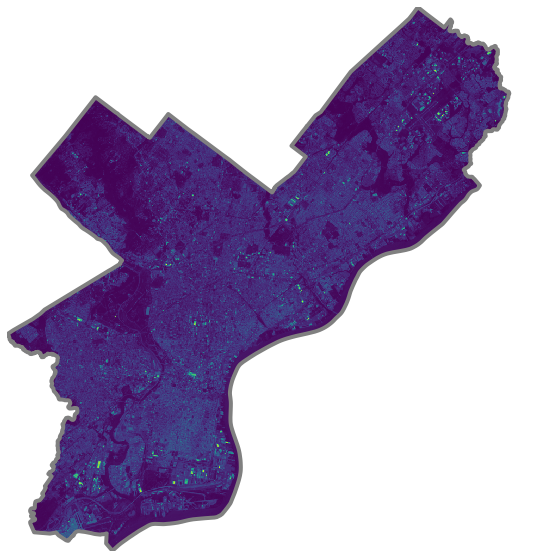

In [89]:
# Initialize
fig, ax = plt.subplots(figsize=(10, 10))

# Plot the first band
plt.imshow(masked[0], cmap="viridis", extent=landsat_extent)

# Format and add the city limits
city_limits.boundary.plot(ax=ax, color="gray", linewidth=4)
ax.set_axis_off()

## Writing GeoTIFF files

Let's save our cropped raster data. To save raster data, we need both the array of the data and the proper meta-data. 

In [90]:
out_meta = landsat.meta
out_meta.update({
             "height": masked.shape[1],
             "width": masked.shape[2],
             "transform": mask_transform})
print(out_meta)

# write small image to local Geotiff file
with rio.open('data/cropped_landsat.tif', 'w', **out_meta) as dst:
    dst.write(masked)

{'driver': 'GTiff', 'dtype': 'uint16', 'nodata': None, 'width': 923, 'height': 999, 'count': 10, 'crs': CRS.from_epsg(32618), 'transform': Affine(30.0, 0.0, 476064.3596176505,
       0.0, -30.0, 4443066.927074196)}


In [92]:
landsat

<open DatasetReader name='./data/landsat8_philly.tif' mode='r'>

Note: we used a *context manager* above (the "with" statement) to handle the opening and subsequent closing of our new file.

For more info, see [this tutorial](https://www.earthdatascience.org/workshops/gis-open-source-python/open-lidar-raster-python/).

## Now let's do some raster math

Often called "map algebra"...

## The Normalized Difference Vegetation Index

- A normalized index of greenness ranging from -1 to 1, calculated from the red and NIR bands. 
- Provides a measure of the amount of live green vegetation in an area

**Formula:**

NDVI = (NIR - Red) / (NIR + Red)

Healthy vegetation reflects NIR and absorbs visible, so the NDVI for green vegatation

## Get the data for the red and NIR bands

NIR is band 5 and red is band 4

In [95]:
masked.shape

(10, 999, 923)

In [96]:
# Note that the indexing here is zero-based, e.g., band 1 is index 0
red = masked[3]
nir = masked[4]

In [97]:
def calculate_NDVI(nir, red):
    """
    Calculate the NDVI from the NIR and red landsat bands
    """
    
    # Convert to floats
    nir = nir.astype(float)
    red = red.astype(float)
    
    # Get valid entries
    check = np.logical_and( red.mask == False, nir.mask == False )
    
    # Where the check is True, return the NDVI, else return NaN
    ndvi = np.where(check,  (nir - red ) / ( nir + red ), np.nan )
    return ndvi 


In [98]:
NDVI = calculate_NDVI(nir, red)

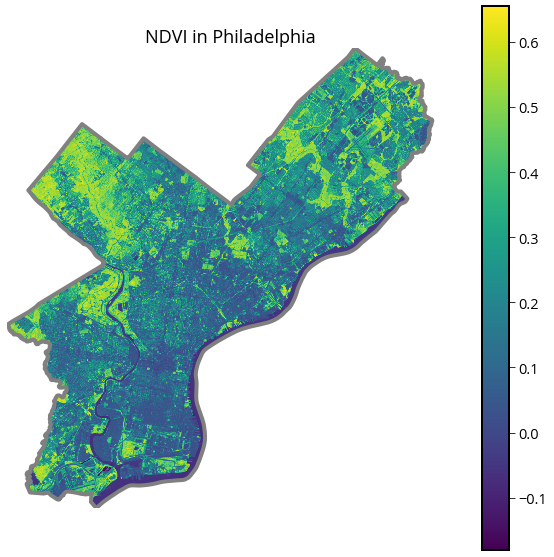

In [99]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot NDVI
img = ax.imshow(NDVI, extent=landsat_extent)

# Format and plot city limits
city_limits.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=4)
plt.colorbar(img)
ax.set_axis_off()
ax.set_title("NDVI in Philadelphia", fontsize=18);

## Let's overlay Philly's parks

In [100]:
# Read in the parks dataset
parks = gpd.read_file('./data/parks.geojson')

In [101]:
# Print out the CRS
parks.crs

{'init': 'epsg:4326'}

In [102]:
# Conver to landsat CRS
parks = parks.to_crs(landsat.crs.data)

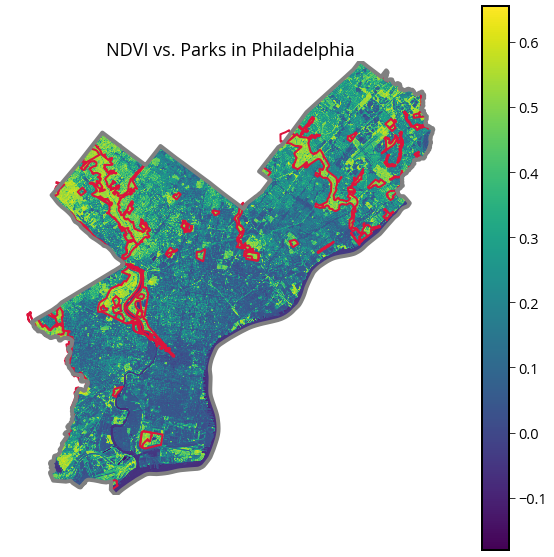

In [103]:
fig, ax = plt.subplots(figsize=(10,10))

# Plot NDVI
img = ax.imshow(NDVI, extent=landsat_extent)

# NEW: add the parks
parks.plot(ax=ax, edgecolor='crimson', facecolor='none', linewidth=2)

# Format and plot city limits
city_limits.plot(ax=ax, edgecolor='gray', facecolor='none', linewidth=4)
plt.colorbar(img)
ax.set_axis_off()
ax.set_title("NDVI vs. Parks in Philadelphia", fontsize=18);

It looks like it worked pretty well!

## How about calculating the median NDVI within the park geometries?

This is called *zonal statistics*. We can use the `rasterstats` package to do this...

In [104]:
from rasterstats import zonal_stats

In [105]:
stats = zonal_stats(parks, NDVI, affine=landsat.transform, stats=['mean', 'median'])

/Users/nhand/anaconda3/envs/py37/lib/python3.7/site-packages/rasterstats/io.py:300: UserWarning: Setting nodata to -999; specify nodata explicitly
  warnings.warn("Setting nodata to -999; specify nodata explicitly")


In [106]:
stats

[{'mean': 0.5051087300747117, 'median': 0.521160491292894},
 {'mean': 0.441677258928841, 'median': 0.47791901454593105},
 {'mean': 0.4885958179164529, 'median': 0.5084981442485412},
 {'mean': 0.3756264171005127, 'median': 0.42356277391080177},
 {'mean': 0.45897667566035816, 'median': 0.49204860985900256},
 {'mean': 0.4220467885671325, 'median': 0.46829433706341134},
 {'mean': 0.38363107808041097, 'median': 0.416380868090128},
 {'mean': 0.4330996771737791, 'median': 0.4772304906066629},
 {'mean': 0.45350534061220404, 'median': 0.5015001304461257},
 {'mean': 0.44505112880627273, 'median': 0.4701653486700216},
 {'mean': 0.5017048095513129, 'median': 0.5108644957689836},
 {'mean': 0.23745576631277313, 'median': 0.24259729272419628},
 {'mean': 0.31577818701756977, 'median': 0.3306512446567765},
 {'mean': 0.5300954792288528, 'median': 0.5286783042394015},
 {'mean': 0.4138823685577781, 'median': 0.4604562737642586},
 {'mean': 0.48518030764354636, 'median': 0.5319950233699855},
 {'mean': 0.315

In [107]:
len(parks)

63

In [108]:
# Store the median value in the parks data frame
parks['median_NDVI'] = [s['median'] for s in stats]

## Make a quick histogram of the median values

They are all positive, indicating an abundance of green vegetation...

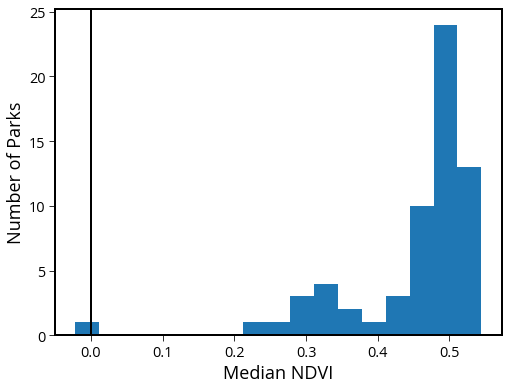

In [109]:
# Initialize
fig, ax = plt.subplots(figsize=(8,6))

# Plot a quick histogram 
ax.hist(parks['median_NDVI'], bins='auto')
ax.axvline(x=0, c='k', lw=2)

# Format
ax.set_xlabel("Median NDVI", fontsize=18)
ax.set_ylabel("Number of Parks", fontsize=18);

## Let's make a choropleth, too

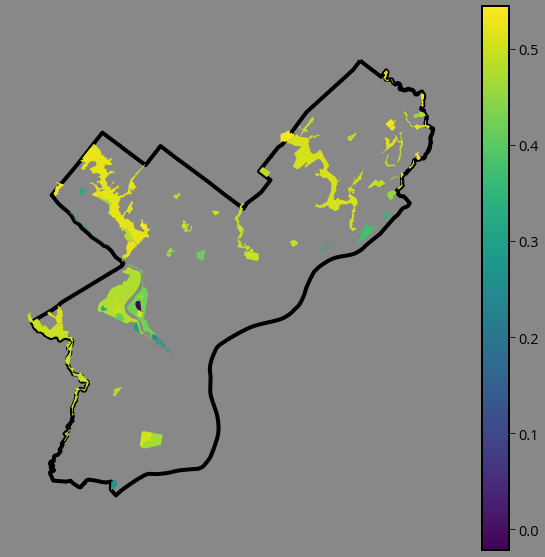

In [110]:
# Initialize
fig, ax = plt.subplots(figsize=(10,10), facecolor='#888888')

# Plot the city limits
city_limits.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=4)

# Plot the median NDVI
parks.plot(column='median_NDVI', legend=True, ax=ax)

# Format
ax.set_axis_off()

## Let's make it interactive!

In [111]:
# trim to only the columns we want to plot
cols = ["median_NDVI", "SITE_NAME", "geometry"]

# Plot the parks colored by median NDVI
p = parks[cols].hvplot.polygons(c="median_NDVI", geo=True, crs=32618)

# Plot the city limit boundary
cl = city_limits.hvplot.polygons(
    geo=True,
    crs=32618,
    alpha=0,
    line_alpha=1,
    line_color="black",
    hover=False,
    width=700,
    height=600,
)

# combine!
cl * p

:Overlay
   .Polygons.I  :Polygons   [Longitude,Latitude]   (OBJECTID,Shape__Area,Shape__Length)
   .Polygons.II :Polygons   [Longitude,Latitude]   (median_NDVI,SITE_NAME)

## Exercise: Measure the median NDVI for each of Philadelphia's neighborhoods

- A GeoJSON file of Philly's neighborhoods is available in the "data/" folder
- Once you measure the median value for each neighborhood, make the following charts:
    - A histogram of the median values for all neighborhoods
    - Bar graphs with the neighborhoods with the 10 highest and 10 lowest values
    - A choropleth showing the median values across the city
    
You're welcome to use matplotlib/geopandas, but encouraged to explore the new hvplot options!

In [112]:
# Load the neighborhoods
hoods = gpd.read_file("./data/zillow_neighborhoods.geojson").to_crs(landsat.crs.data)

In [113]:
# Calculate the zonal statistics
stats_by_hood = zonal_stats(hoods, NDVI, affine=landsat.transform, stats=['mean', 'median'])

/Users/nhand/anaconda3/envs/py37/lib/python3.7/site-packages/rasterstats/io.py:300: UserWarning: Setting nodata to -999; specify nodata explicitly
  warnings.warn("Setting nodata to -999; specify nodata explicitly")


In [114]:
# Store the median value in the neighborhood data frame
hoods['median_NDVI'] = [s['median'] for s in stats_by_hood]

## Make a histogram of median values

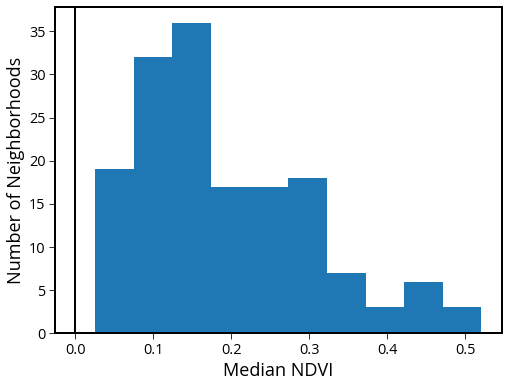

In [116]:
# Initialize
fig, ax = plt.subplots(figsize=(8,6))

# Plot a quick histogram 
ax.hist(hoods['median_NDVI'], bins='auto')
ax.axvline(x=0, c='k', lw=2)

# Format
ax.set_xlabel("Median NDVI", fontsize=18)
ax.set_ylabel("Number of Neighborhoods", fontsize=18);

## Plot a (static) choropleth map

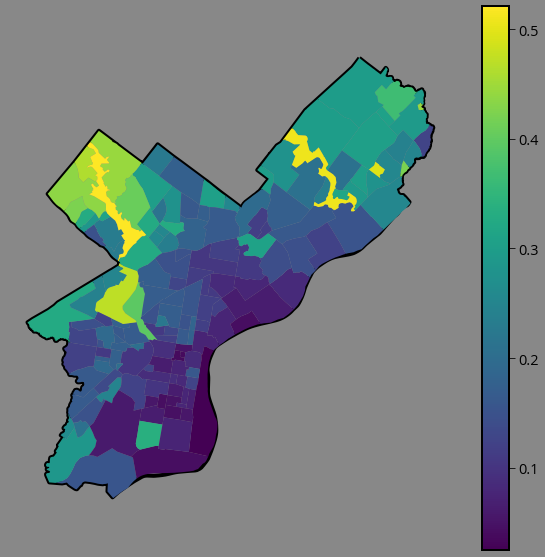

In [117]:
# Initialize
fig, ax = plt.subplots(figsize=(10,10), facecolor='#888888')

# Plot the city limits
city_limits.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=4)

# Plot the median NDVI
hoods.plot(column='median_NDVI', legend=True, ax=ax)

# Format
ax.set_axis_off()

## Plot an (interactive) choropleth map

In [118]:
# trim to only the columns we want to plot
cols = ["median_NDVI", "ZillowName", "geometry"]

# Plot the parks colored by median NDVI
hoods[cols].hvplot.polygons(c="median_NDVI", geo=True, crs=32618, width=700, height=600)

:Polygons   [Longitude,Latitude]   (median_NDVI,ZillowName)

## Plot a bar chart of the neighborhoods with the top 20 largest median values

In [119]:
# calculate the top 20
cols = ['ZillowName', 'median_NDVI']
top20 = hoods[cols].sort_values('median_NDVI', ascending=False).iloc[:20]

top20.hvplot.bar(x='ZillowName', y='median_NDVI', rot=90)

:Bars   [ZillowName]   (median_NDVI)

## Plot a bar chart of the neighborhoods with the bottom 20 largest median values

In [120]:
cols = ['ZillowName', 'median_NDVI']
bottom20 = hoods[cols].sort_values('median_NDVI', ascending=True).iloc[:20]


bottom20.hvplot.bar(x='ZillowName', y='median_NDVI', rot=90)

:Bars   [ZillowName]   (median_NDVI)